## Segmenting Lungs and Mediastinum from Cardiac Scout MR

Brian Hurt | 8/9/2019

Basic Steps to training any Machine Learning/Data-based model, including a Convolutional Neural Network (CNN).

This tutorial will go through training a U-net CNN (https://arxiv.org/abs/1505.04597) to perform 2-D segmentation on Coronal MRI scout films. The model takes one 2-D scout image as an input, and outputs two images, each with identical size as the input but pixel values representing the probability of being the lungs, soft tissue or the mediastinum.

**Conceptual Steps in Building a CNN**
1. Identify data
2. Load & preprocess data
3. Load model and define model parameters
4. Train model. Training is an **iterative optimization process** where you define an objective function (i.e. loss) you aim to minimize using an optimization algorithm (e.g. gradient descent, https://en.wikipedia.org/wiki/Gradient_descent)
5. Evaluate model performance against data not used to train model (i.e. terms like validation or test are frequently used to describe this)

**Software Involved**

Python is the main programming language, but there are several key 3rd party libraries that are used in this process.

- `Keras`/`Tensorflow` - CNN libraries used to build, train, and evaluate the UNET.
- `Pydicom` - Load dicom data
- `Matplotlib/Seaborn` - Plot data, including images
- `Numpy` - Linear algebra/Matrices/Math
- `Pandas` - Tool to organize data into "data frames." Makes it easier to slice through the data

- `rads_keras` - a toolbox build within the lab at UCSD to do common operations with CNNs and radiological data

## 0. Load Libraries
#### First thing in any python file (.py or juypter notebook) is importing libraries

In [1]:
%load_ext autoreload
%autoreload 2

In [18]:
import sys
import os
import glob
import qgrid
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
from keras.optimizers import *
from keras import losses
sys.path.append(r'C:\Users\Alta\Miniconda3\envs\deep\Lib')  # relative path to rads_keras toolbox
sys.path.append(r'C:\Users\Alta\Miniconda3\envs\deep\Lib\site-packages\PIL\Image.py')

In [3]:
from rads_keras import utils
from rads_keras import visualize as vi

## 1. Define Data
#### Need to find and map DICOM files with annotation PNG files

In [4]:
img_dir = r"X:\KWB Files\Arterys Files"
mask_dir = r"X:\KWB Files\3 Plane Loc"

In [5]:
# Get studies with "3Plane"
img_files = glob.glob(os.path.join(img_dir, "**/*3Plane*/*.dcm"), recursive=True)  # takes a while!

In [6]:
search = {
    'images': {'dir': img_dir, 'suffix': "3Plane*/*.dcm"},
    'lungs': {'dir': mask_dir, 'suffix': '__lungs*__g.png'},
    'mediastinum': {'dir': mask_dir, 'suffix': '__ms*__g.png'}
    'soft_tissue': {'dir': mask_dir, 'suffix': '__st*__g.png'}
}
df = utils.create_dataframe(search, key='images', scale_vals=False, img_paths=img_files, leaky_search=False)

# Filter in scouts which have either lungs, soft tissue, or mediastinum annotations
df = df[~df.lungs.isna() | ~df.mediastinum.isna() | ~df.soft_tissue.isna()]

In [7]:
# show data paths in a table format
qgrid.show_grid(df[['images', 'lungs', 'mediastinum', 'soft_tissue']])

QgridWidget(grid_options={'fullWidthRows': True, 'syncColumnCellResize': True, 'forceFitColumns': True, 'defau…

## 2. Load Data
#### Split data into 80% Training and set aside 20% for testing, by series

In [8]:
pct_train = 0.8
unique_series = df.series_name.unique()
num_train = int(pct_train * len(unique_series))
train_df = df[df.series_name.isin(unique_series[:num_train])]
val_df = df[df.series_name.isin(unique_series[num_train:])]

train_df.to_csv('training.csv')
val_df.to_csv('validation.csv')

In [9]:
mask_order = ['lungs', 'mediastinum', 'soft_tissue']  # order which they will be output by the model
train_data = utils.get_data_array(train_df, 
                                  input_name='images', 
                                  output_list=mask_order,
                                  binarize_level=0.5,  # turn masks into 0 or 1
                                  norm_to_one=True  # normalize each pixel between 0 (min pixel) and 1 (max pixel)
                                 )

val_data = utils.get_data_array(val_df, 
                                input_name='images', 
                                output_list=mask_order,
                                binarize_level=0.5,
                                norm_to_one=True
                               )

In [10]:
print("{} training images within {} series | {} validation images within {} series".format(len(train_data[0]), num_train, len(val_data[0]), len(unique_series)-num_train))

601 training images within 42 series | 161 validation images within 11 series


#### Visualize Input Data

In [11]:
x = train_data[0]
y = train_data[1]
cm_lung = vi.single("#b7a57a")
cm_ms = vi.single("#4b2e83")
cm_st = vi.single("#b37698")

def plot_inference(ix):
    r, c, w = 1, 2, 5
    f, ax = plt.subplots(r, c, figsize=(c*w, r*w))
    print(train_df.iloc[ix]['images'])
    print(train_df.iloc[ix]['lungs'])
    print(train_df.iloc[ix]['mediastinum'])
    print(train_df.iloc[ix]['soft_tissue'])
    
    # Plot input
    vi.plot_img(x[ix, ..., 0], ax=ax[0])
    
    # Plot hand annotation
    vi.plot_img(x[ix, ..., 0], ax=ax[1])
    vi.plt_probability_map_mpl(y[ix, ..., 0], cmap_name=cm_lung, ax=ax[1])
    vi.plt_probability_map_mpl(y[ix, ..., 1], cmap_name=cm_ms, ax=ax[1])
    vi.plt_probability_map_mpl(y[ix, ..., 2], cmap_name=cm_st, ax=ax[1])
    
    plt.subplots_adjust(wspace=0.01, hspace=0.01)

interact(plot_inference, ix=widgets.IntSlider(min=0, max=len(x)-1, step=1, value=0));

interactive(children=(IntSlider(value=0, description='ix', max=600), Output()), _dom_classes=('widget-interact…

## 3. Build U-net Model

See the U-net paper: https://arxiv.org/abs/1505.04597

Keras code adapted from: https://github.com/zhixuhao/unet

In [12]:
from keras.models import Model
from keras.layers import *
from keras.backend import tf as K

def UNET(pretrained_weights=None, input_shape=(224, 224), input_channels=1, n_classes=1, kernel_size=3, initial_filters=32, dropout_val=0.2,):
    """
    Method to produce the U-net model in Keras.
    
    Returns keras model object
    """

    def double_conv_layer(x, filter_banks, kernel_size=3, dropout=0.0, batch_norm=True):
        """Helper method to reduce redundant code."""
        axis = 3
        conv = Conv2D(filter_banks, (kernel_size, kernel_size), padding='same')(x)
        if batch_norm is True:
            conv = BatchNormalization(axis=axis)(conv)
        conv = Activation('relu')(conv)
        conv = Conv2D(filter_banks, (kernel_size, kernel_size), padding='same')(conv)
        if batch_norm is True:
            conv = BatchNormalization(axis=axis)(conv)
        conv = Activation('relu')(conv)
        if dropout > 0:
            conv = SpatialDropout2D(dropout)(conv)
        return conv

    inputs = Input((input_shape[0], input_shape[1], input_channels))
    axis = 3
    filters = initial_filters

    # encoding portion
    conv_224 = double_conv_layer(inputs, filters, kernel_size)  
    pool_112 = MaxPooling2D(pool_size=(2, 2))(conv_224)

    conv_112 = double_conv_layer(pool_112, 2*filters, kernel_size)
    pool_56 = MaxPooling2D(pool_size=(2, 2))(conv_112)

    conv_56 = double_conv_layer(pool_56, 4*filters, kernel_size)
    pool_28 = MaxPooling2D(pool_size=(2, 2))(conv_56)

    conv_28 = double_conv_layer(pool_28, 8*filters, kernel_size)
    pool_14 = MaxPooling2D(pool_size=(2, 2))(conv_28)

    conv_14 = double_conv_layer(pool_14, 16*filters, kernel_size)
    pool_7 = MaxPooling2D(pool_size=(2, 2))(conv_14)

    conv_7 = double_conv_layer(pool_7, 32*filters, kernel_size) 

    # start decoding
    up_14 = concatenate([UpSampling2D(size=(2, 2))(conv_7), conv_14], axis=axis)
    up_conv_14 = double_conv_layer(up_14, 16*filters, kernel_size)

    up_28 = concatenate([UpSampling2D(size=(2, 2))(up_conv_14), conv_28], axis=axis)
    up_conv_28 = double_conv_layer(up_28, 8*filters, kernel_size)

    up_56 = concatenate([UpSampling2D(size=(2, 2))(up_conv_28), conv_56], axis=axis)
    up_conv_56 = double_conv_layer(up_56, 4*filters, kernel_size)

    up_112 = concatenate([UpSampling2D(size=(2, 2))(up_conv_56), conv_112], axis=axis)
    up_conv_112 = double_conv_layer(up_112, 2*filters, kernel_size)

    up_224 = concatenate([UpSampling2D(size=(2, 2))(up_conv_112), conv_224], axis=axis)
    up_conv_224 = double_conv_layer(up_224, filters, kernel_size, dropout_val)

    conv_final = Conv2D(n_classes, (1, 1))(up_conv_224)
    conv_final = Activation('sigmoid')(conv_final)
    
    # Build "Model" keras object
    model = Model(inputs, conv_final, name="UNET_BHurt")

    # load prior weights, if given
    if pretrained_weights:
        model.load_weights(pretrained_weights)

    return model

In [13]:
# Call the method defined in the previous cell
model = UNET(input_shape=(256, 256), input_channels=1, n_classes=len(mask_order), initial_filters=32)

In [14]:
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 256, 256, 1)  0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 256, 256, 32) 320         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization_1 (BatchNor (None, 256, 256, 32) 128         conv2d_1[0][0]                   
__________________________________________________________________________________________________
activation_1 (Activation)       (None, 256, 256, 32) 0           batch_normalization_1[0][0]      
__________________________________________________________________________________________________
conv2d_2 (

In [15]:
# Compile = Setting up loss and optimization parameters
model.compile(optimizer=Adam(lr=5e-4), loss=losses.binary_crossentropy)

## 4. Train Model

In [16]:
model.fit(x=train_data[0], y=train_data[1], epochs=40, batch_size=4, validation_data=(val_data[0], val_data[1]))

Train on 601 samples, validate on 161 samples
Epoch 1/40
601/601 [==============================] - 23s 38ms/step - loss: 0.3250 - val_loss: 0.3511
Epoch 2/40
601/601 [==============================] - 16s 27ms/step - loss: 0.1627 - val_loss: 0.3790
Epoch 3/40
601/601 [==============================] - 16s 27ms/step - loss: 0.1038 - val_loss: 0.1117
Epoch 4/40
601/601 [==============================] - 17s 28ms/step - loss: 0.0769 - val_loss: 0.0707
Epoch 5/40
601/601 [==============================] - 16s 27ms/step - loss: 0.0629 - val_loss: 0.0564
Epoch 6/40
601/601 [==============================] - 17s 28ms/step - loss: 0.0537 - val_loss: 0.0567
Epoch 7/40
601/601 [==============================] - 17s 28ms/step - loss: 0.0480 - val_loss: 0.0594
Epoch 8/40
601/601 [==============================] - 17s 27ms/step - loss: 0.0447 - val_loss: 0.0552
Epoch 9/40
601/601 [==============================] - 17s 28ms/step - loss: 0.0408 - val_loss: 0.0453
Epoch 10/40
601/601 [===============

In [18]:
model.save('lung_ms_st.h5')

In [12]:
from keras.models import load_model
model = load_model('lung_ms_st.h5')

### Evaluate Training Technical Performance

In [13]:
# Standard ploting of training and validation loss
history = model.history.history
epochs = range(1,len(next(iter(history.values())))+1)
pd.DataFrame(history, index=epochs)

sns.set_context("talk")
sns.set_style("whitegrid")
plt.figure(figsize=(10,6))

ax = plt.subplot(111)
plt.plot(epochs, history["loss"], label="Training loss")
plt.plot(epochs, history["val_loss"], label="Validation loss")
plt.legend(loc='best')
plt.title("U-net Training Loss with Epochs")

AttributeError: 'Model' object has no attribute 'history'

## 5. Run Inference and Visualize Predictions

In [14]:
x = val_data[0]  # MR images
y = val_data[1]  # hand annotations
yp = model.predict(x, batch_size=4, verbose=1)  # predictions

161/161 [==============================] - 4s 26ms/step


## Evaluate

In [19]:
mask_order = ['lungs', 'mediastinum', 'soft_tissue']  # order which they will be output by the model

val_data = utils.get_data_array(val_df, 
                                input_name='images', 
                                output_list=mask_order,
                                binarize_level=0.5,
                                norm_to_one=True
                               )
x = val_data[0]  # MR images
y_true = val_data[1]  # hand annotations
y_pred = model.predict(x, batch_size=4, verbose=1)  # predictions

161/161 [==============================] - 2s 11ms/step


In [20]:
threshold, upper, lower = 0.5, 1, 0
y_true[y_true>threshold] = upper
y_true[y_true<=threshold] = lower
y_pred[y_pred>threshold] = upper
y_pred[y_pred<=threshold] = lower


In [21]:

dice_lung=[]
for i in range(161):
#     print(y_true.shape)
#     print(y_pred.shape)
    lung_true_temp = y_true[i,:,:,0]
    lung_pred_temp = y_pred[i,:,:,0]
    tol = 1e-9
    dice_lung.append(np.sum((2*(lung_true_temp * lung_pred_temp))) / np.sum( lung_true_temp + lung_pred_temp + tol))
#     dice_lung=(2*(y_true[i, ..., 0]*y_pred[i, ..., 0]))/(sum(y_true[i, ..., 0])+sum(y_pred[i, ..., 0])+0.000000000001)
#     dice_ms=(2*(y_true[i, ..., 1]*y_pred[i, ..., 1]))/(sum(y_true[i, ..., 1])+sum(y_pred[i, ..., 1])+0.000000000001)
dice_lung=np.hstack(dice_lung)
# print(dice_ms)

In [22]:
dice_ms=[]
for i in range(161):
    ms_true_temp = y_true[i,:,:,1]
    ms_pred_temp = y_pred[i,:,:,1]
    tol = 1e-9
    dice_ms.append(np.sum((2*(ms_true_temp * ms_pred_temp))) / np.sum( ms_true_temp + ms_pred_temp + tol))
#     dice_lung=(2*(y_true[i, ..., 0]*y_pred[i, ..., 0]))/(sum(y_true[i, ..., 0])+sum(y_pred[i, ..., 0])+0.000000000001)
#     dice_ms=(2*(y_true[i, ..., 1]*y_pred[i, ..., 1]))/(sum(y_true[i, ..., 1])+sum(y_pred[i, ..., 1])+0.000000000001)
dice_ms=np.hstack(dice_ms)

In [23]:
print(dice_ms)

[0.         0.         0.         0.71470585 0.93695919 0.55908288
 0.73856523 0.84536958 0.9051827  0.91308089 0.95394549 0.95546344
 0.92223185 0.95945804 0.92653252 0.93607732 0.93509981 0.9335119
 0.94276911 0.         0.         0.         0.89552237 0.91414885
 0.90923716 0.89420164 0.90767944 0.9042657  0.84401113 0.72894332
 0.         0.80804949 0.91774301 0.88373738 0.94476045 0.94896457
 0.90534049 0.96042025 0.95206875 0.94706814 0.94742376 0.89066584
 0.90607734 0.93174935 0.70368834 0.         0.         0.
 0.76788319 0.85648432 0.92162685 0.94255252 0.94507222 0.94773519
 0.90787844 0.92029215 0.94711483 0.95049504 0.96397675 0.94783355
 0.95622019 0.86816524 0.92580777 0.91871289 0.92946304 0.85062387
 0.82862088 0.         0.951417   0.94726295 0.88030614 0.94012766
 0.94251894 0.91120813 0.86857994 0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.80251344 0.85139393
 0.82451575 0.834247

In [24]:
import numpy as np

In [42]:
corr_dice_lung=[]
for i in range(161):
    if np.sum(lung_true_temp[i])<1 and np.sum(lung_pred_temp[i])<1:
        corr_dice_lung.append(np.nan)
    else:
        corr_dice_lung.append(dice_lung[i])
    
corr_dice_lung=np.hstack(corr_dice_lung)
corr_dice_lung

array([       nan,        nan,        nan,        nan,        nan,
              nan,        nan,        nan,        nan,        nan,
              nan,        nan,        nan,        nan,        nan,
              nan,        nan,        nan,        nan,        nan,
              nan,        nan,        nan,        nan,        nan,
              nan,        nan,        nan,        nan,        nan,
              nan,        nan,        nan,        nan,        nan,
              nan,        nan,        nan,        nan,        nan,
              nan,        nan,        nan,        nan,        nan,
              nan,        nan,        nan,        nan,        nan,
              nan, 0.9635079 , 0.96010933, 0.9410698 , 0.94719673,
       0.94284386, 0.94501188, 0.86827032, 0.84859426, 0.83848795,
       0.90821072, 0.95705271, 0.94702842, 0.92536395, 0.92021514,
       0.97104157, 0.91562838, 0.74490927, 0.94399202, 0.92673855,
       0.94463213, 0.93324877, 0.9319389 , 0.9339207 , 0.92742

In [44]:
corr_dice_ms=[]
for i in range(161):
    if np.sum(ms_true_temp[i])<1 and np.sum(ms_pred_temp[i])<1:
        corr_dice_ms.append(np.nan)
    else:
        corr_dice_ms.append(dice_ms[i])
    
corr_dice_ms=np.hstack(corr_dice_ms)
corr_dice_ms

array([       nan,        nan,        nan,        nan,        nan,
              nan,        nan,        nan,        nan,        nan,
              nan,        nan,        nan,        nan,        nan,
              nan,        nan,        nan,        nan,        nan,
              nan,        nan,        nan,        nan,        nan,
              nan,        nan,        nan,        nan,        nan,
              nan,        nan,        nan,        nan,        nan,
              nan,        nan,        nan,        nan,        nan,
              nan,        nan,        nan,        nan,        nan,
              nan,        nan,        nan,        nan,        nan,
              nan,        nan,        nan,        nan,        nan,
              nan,        nan,        nan,        nan,        nan,
              nan,        nan,        nan, 0.91871289, 0.92946304,
       0.85062387, 0.82862088, 0.        , 0.951417  , 0.94726295,
       0.88030614, 0.94012766, 0.94251894, 0.91120813, 0.86857

In [26]:
type(dice_ms)

numpy.ndarray

In [79]:
def plot_inference(ix):
    r, c, w = 1, 3, 5
    f, ax = plt.subplots(r, c, figsize=(c*w, r*w))
    print(train_df.iloc[ix]['series_name'])
    print(train_df.iloc[ix]['images'])
    print(train_df.iloc[ix]['lungs'])
    print(train_df.iloc[ix]['mediastinum'])
    print(train_df.iloc[ix]['soft_tissue'])

    # Plot input
    vi.plot_img(x[ix, ..., 0], ax=ax[0])

    
    # Plot hand annotation
    vi.plot_img(x[ix, ..., 0], ax=ax[1])
    vi.plt_probability_map_mpl(y[ix, ..., 0], cmap_name=cm_lung, ax=ax[1])
    vi.plt_probability_map_mpl(y[ix, ..., 1], cmap_name=cm_ms, ax=ax[1])
    vi.plt_probability_map_mpl(y[ix, ..., 1], cmap_name=cm_st, ax=ax[1])
    
    # Plot predicted
    vi.plot_img(x[ix, ..., 0], ax=ax[2])
    vi.plt_probability_map_mpl(yp[ix, ..., 0], cmap_name=cm_lung, ax=ax[2])
    vi.plt_probability_map_mpl(yp[ix, ..., 1], cmap_name=cm_ms, ax=ax[2])

    plt.subplots_adjust(wspace=0.01, hspace=0.01)
    plt.text(-13.5, 40,"{} | Lung Dice = {} | Mediastinum Dice = {} | Soft Tissue Dice = {}".format(train_df.iloc[ix]['images'], dice_lung[ix], dice_ms[ix], dice_st[ix]), color='white')

Arodug\7_3Plane_Loc_SSFSE_NBH
X:\KWB Files\Arterys Files\Arodug\7_3Plane_Loc_SSFSE_NBH\7_3Plane_Loc_SSFSE_NBH_16.dcm
X:\KWB Files\3 Plane Loc\Arodug\7_3Plane_Loc_SSFSE_NBH\7_3Plane_Loc_SSFSE_NBH_16__cor_lungs__AS__g.png
X:\KWB Files\3 Plane Loc\Arodug\7_3Plane_Loc_SSFSE_NBH\7_3Plane_Loc_SSFSE_NBH_16__cor_ms__AS__g.png


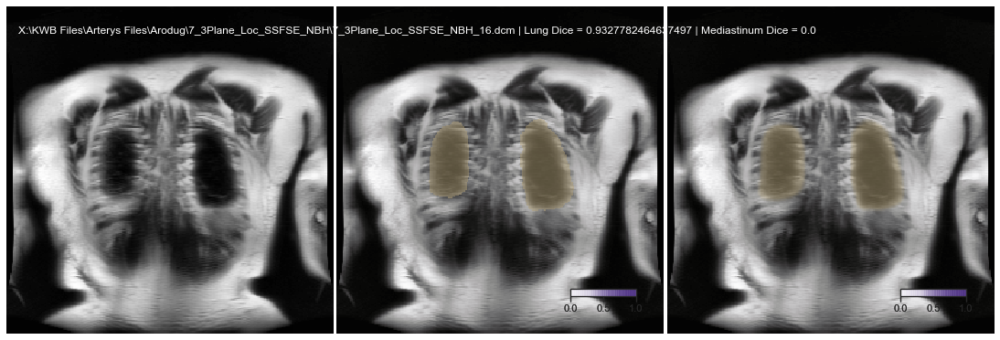

In [80]:
plot_inference(0)

Arodug\7_3Plane_Loc_SSFSE_NBH
X:\KWB Files\Arterys Files\Arodug\7_3Plane_Loc_SSFSE_NBH\7_3Plane_Loc_SSFSE_NBH_16.dcm
X:\KWB Files\3 Plane Loc\Arodug\7_3Plane_Loc_SSFSE_NBH\7_3Plane_Loc_SSFSE_NBH_16__cor_lungs__AS__g.png
X:\KWB Files\3 Plane Loc\Arodug\7_3Plane_Loc_SSFSE_NBH\7_3Plane_Loc_SSFSE_NBH_16__cor_ms__AS__g.png
Arodug\7_3Plane_Loc_SSFSE_NBH
X:\KWB Files\Arterys Files\Arodug\7_3Plane_Loc_SSFSE_NBH\7_3Plane_Loc_SSFSE_NBH_17.dcm
X:\KWB Files\3 Plane Loc\Arodug\7_3Plane_Loc_SSFSE_NBH\7_3Plane_Loc_SSFSE_NBH_17__cor_lungs__AS__g.png
X:\KWB Files\3 Plane Loc\Arodug\7_3Plane_Loc_SSFSE_NBH\7_3Plane_Loc_SSFSE_NBH_17__cor_ms__AS__g.png
Arodug\7_3Plane_Loc_SSFSE_NBH
X:\KWB Files\Arterys Files\Arodug\7_3Plane_Loc_SSFSE_NBH\7_3Plane_Loc_SSFSE_NBH_18.dcm
X:\KWB Files\3 Plane Loc\Arodug\7_3Plane_Loc_SSFSE_NBH\7_3Plane_Loc_SSFSE_NBH_18__cor_lungs__AS__g.png
X:\KWB Files\3 Plane Loc\Arodug\7_3Plane_Loc_SSFSE_NBH\7_3Plane_Loc_SSFSE_NBH_18__cor_ms__AS__g.png
Arodug\7_3Plane_Loc_SSFSE_NBH
X:\KWB Fil

C:\Users\Alta\Miniconda3\envs\deep\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


Asepud\1_3Plane_Loc_SSFSE_NBH
X:\KWB Files\Arterys Files\Asepud\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_36.dcm
X:\KWB Files\3 Plane Loc\Asepud\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_36__cor_lungs__AS__g.png
X:\KWB Files\3 Plane Loc\Asepud\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_36__cor_ms__AS__g.png
Asepud\1_3Plane_Loc_SSFSE_NBH
X:\KWB Files\Arterys Files\Asepud\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_37.dcm
X:\KWB Files\3 Plane Loc\Asepud\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_37__cor_lungs__AS__g.png
X:\KWB Files\3 Plane Loc\Asepud\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_37__cor_ms__AS__g.png
Asepud\1_3Plane_Loc_SSFSE_NBH
X:\KWB Files\Arterys Files\Asepud\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_38.dcm
X:\KWB Files\3 Plane Loc\Asepud\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_38__cor_lungs__AS__g.png
X:\KWB Files\3 Plane Loc\Asepud\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_38__cor_ms__AS__g.png
Asepud\1_3Plane_Loc_SSFSE_NBH
X:\KWB Fil

Ayoosuel\1_3Plane_Loc_SSFSE_NBH
X:\KWB Files\Arterys Files\Ayoosuel\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_33.dcm
X:\KWB Files\3 Plane Loc\Ayoosuel\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_33__cor_lungs__AS__g.png
X:\KWB Files\3 Plane Loc\Ayoosuel\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_33__cor_ms__AS__g.png
Ayoosuel\1_3Plane_Loc_SSFSE_NBH
X:\KWB Files\Arterys Files\Ayoosuel\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_34.dcm
X:\KWB Files\3 Plane Loc\Ayoosuel\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_34__cor_lungs__AS__g.png
X:\KWB Files\3 Plane Loc\Ayoosuel\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_34__cor_ms__AS__g.png
Ayoosuel\1_3Plane_Loc_SSFSE_NBH
X:\KWB Files\Arterys Files\Ayoosuel\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_35.dcm
X:\KWB Files\3 Plane Loc\Ayoosuel\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_35__cor_lungs__AS__g.png
X:\KWB Files\3 Plane Loc\Ayoosuel\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_35__cor_ms__AS__g.png
Ayoosuel\1_3Plan

Bascuten\1_3Plane_Loc_SSFSE_NBH
X:\KWB Files\Arterys Files\Bascuten\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_43.dcm
X:\KWB Files\3 Plane Loc\Bascuten\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_43__cor_lungs__AS__g.png
X:\KWB Files\3 Plane Loc\Bascuten\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_43__cor_ms__AS__g.png
Bascuten\1_3Plane_Loc_SSFSE_NBH
X:\KWB Files\Arterys Files\Bascuten\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_44.dcm
X:\KWB Files\3 Plane Loc\Bascuten\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_44__cor_lungs__AS__g.png
X:\KWB Files\3 Plane Loc\Bascuten\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_44__cor_ms__AS__g.png
Bascuten\1_3Plane_Loc_SSFSE_NBH
X:\KWB Files\Arterys Files\Bascuten\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_45.dcm
X:\KWB Files\3 Plane Loc\Bascuten\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_45__cor_lungs__AS__g.png
X:\KWB Files\3 Plane Loc\Bascuten\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_45__cor_ms__AS__g.png
Bastetof\1_3Plan

Bigronie\1_3Plane_Loc_SSFSE_NBH
X:\KWB Files\Arterys Files\Bigronie\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_38.dcm
X:\KWB Files\3 Plane Loc\Bigronie\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_38__cor_lungs__AS__g.png
X:\KWB Files\3 Plane Loc\Bigronie\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_38__cor_ms__AS__g.png
Bigronie\1_3Plane_Loc_SSFSE_NBH
X:\KWB Files\Arterys Files\Bigronie\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_39.dcm
X:\KWB Files\3 Plane Loc\Bigronie\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_39__cor_lungs__AS__g.png
X:\KWB Files\3 Plane Loc\Bigronie\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_39__cor_ms__AS__g.png
Bigronie\1_3Plane_Loc_SSFSE_NBH
X:\KWB Files\Arterys Files\Bigronie\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_40.dcm
X:\KWB Files\3 Plane Loc\Bigronie\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_40__cor_lungs__AS__g.png
X:\KWB Files\3 Plane Loc\Bigronie\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_40__cor_ms__AS__g.png
Bigronie\1_3Plan

Blupeco\1_3Plane_Loc_SSFSE_NBH
X:\KWB Files\Arterys Files\Blupeco\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_34.dcm
X:\KWB Files\3 Plane Loc\Blupeco\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_34__cor_lungs__AS__g.png
X:\KWB Files\3 Plane Loc\Blupeco\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_34__cor_ms__AS__g.png
Blupeco\1_3Plane_Loc_SSFSE_NBH
X:\KWB Files\Arterys Files\Blupeco\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_35.dcm
X:\KWB Files\3 Plane Loc\Blupeco\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_35__cor_lungs__AS__g.png
X:\KWB Files\3 Plane Loc\Blupeco\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_35__cor_ms__AS__g.png
Blupeco\1_3Plane_Loc_SSFSE_NBH
X:\KWB Files\Arterys Files\Blupeco\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_36.dcm
X:\KWB Files\3 Plane Loc\Blupeco\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_36__cor_lungs__AS__g.png
X:\KWB Files\3 Plane Loc\Blupeco\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_36__cor_ms__AS__g.png
Blupeco\1_3Plane_Loc_SSFSE_N

Bokita\1_3Plane_Loc_SSFSE_NBH
X:\KWB Files\Arterys Files\Bokita\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_44.dcm
X:\KWB Files\3 Plane Loc\Bokita\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_44__cor_lungs__AS__g.png
X:\KWB Files\3 Plane Loc\Bokita\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_44__cor_ms__AS__g.png
Bongubquef\1_3Plane_Loc_SSFSE_NBH
X:\KWB Files\Arterys Files\Bongubquef\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_31.dcm
X:\KWB Files\3 Plane Loc\Bongubquef\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_31__cor_lungs__AS__g.png
X:\KWB Files\3 Plane Loc\Bongubquef\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_31__cor_ms__AS__g.png
Bongubquef\1_3Plane_Loc_SSFSE_NBH
X:\KWB Files\Arterys Files\Bongubquef\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_32.dcm
X:\KWB Files\3 Plane Loc\Bongubquef\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_32__cor_lungs__AS__g.png
X:\KWB Files\3 Plane Loc\Bongubquef\1_3Plane_Loc_SSFSE_NBH\1_3Plane_Loc_SSFSE_NBH_32__cor_ms__AS__g.png
Bongubqu

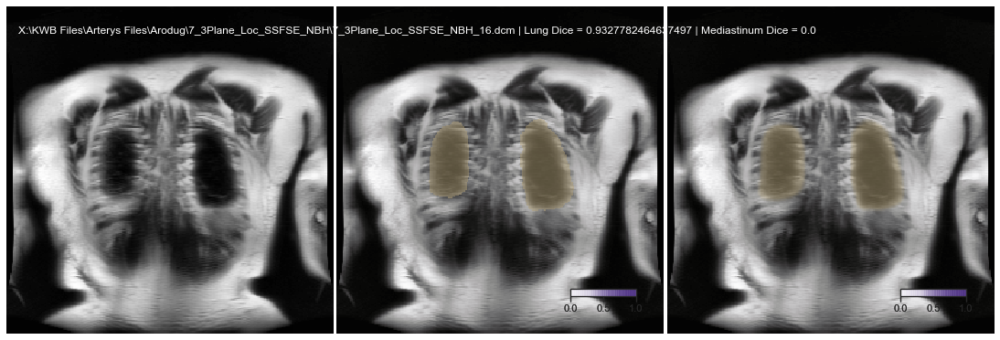

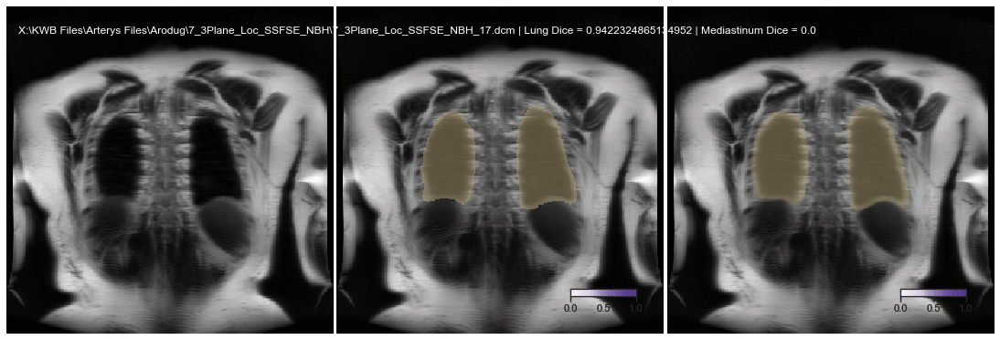

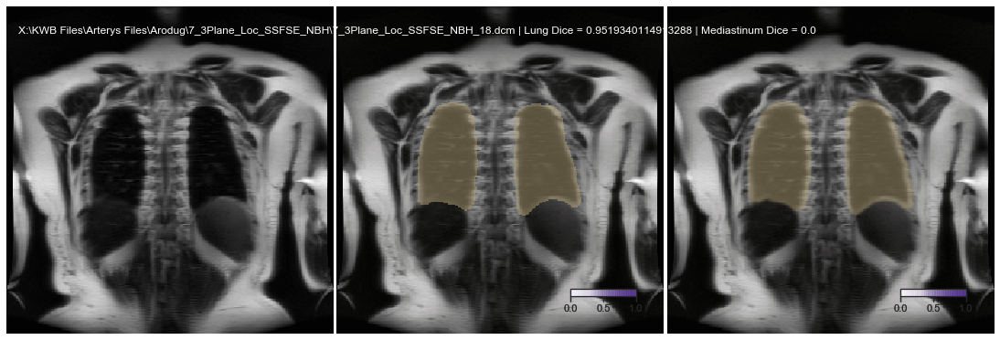

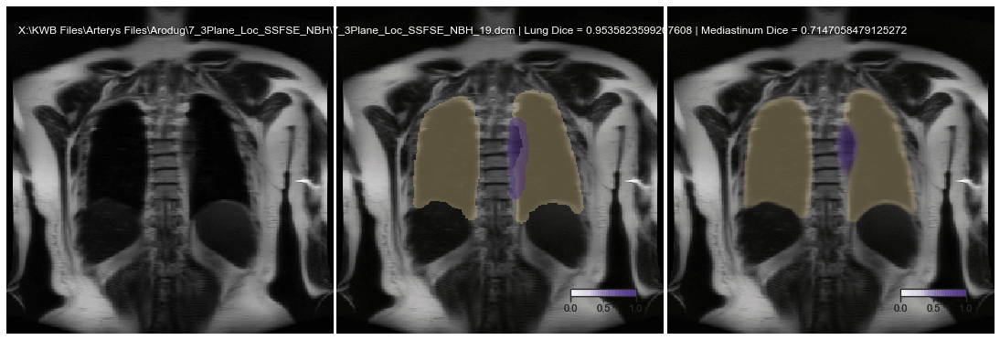

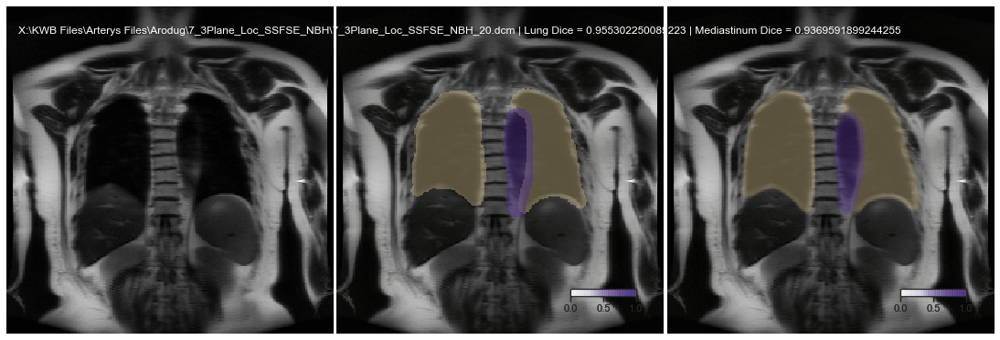

...

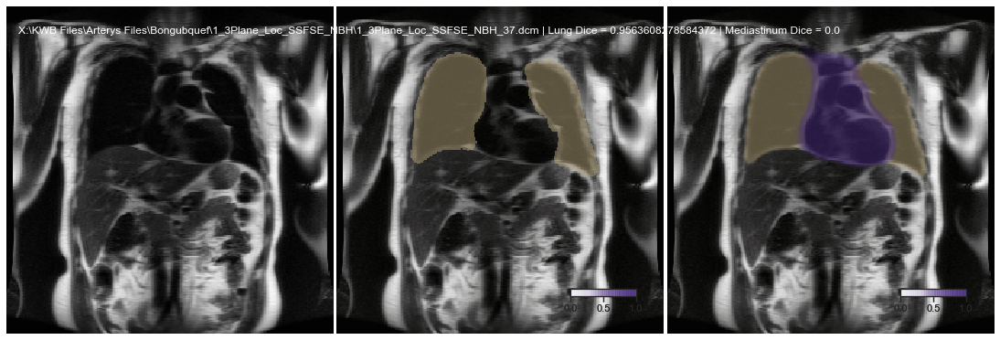

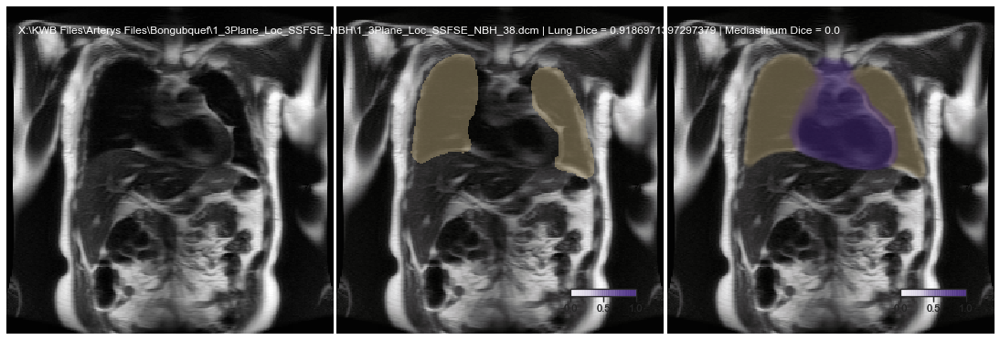

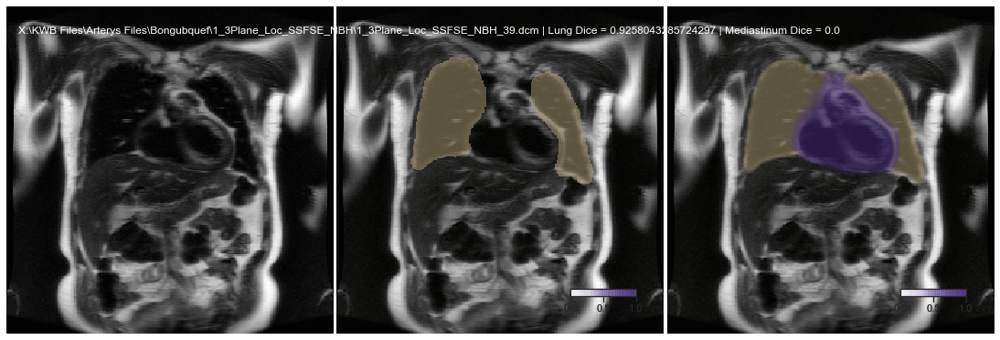

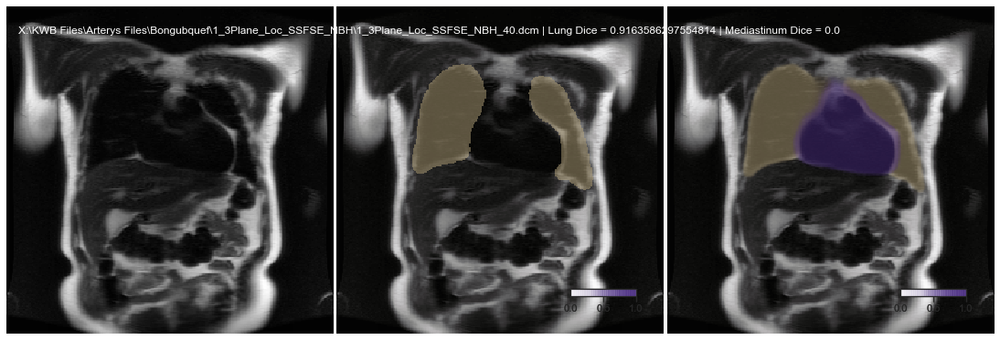

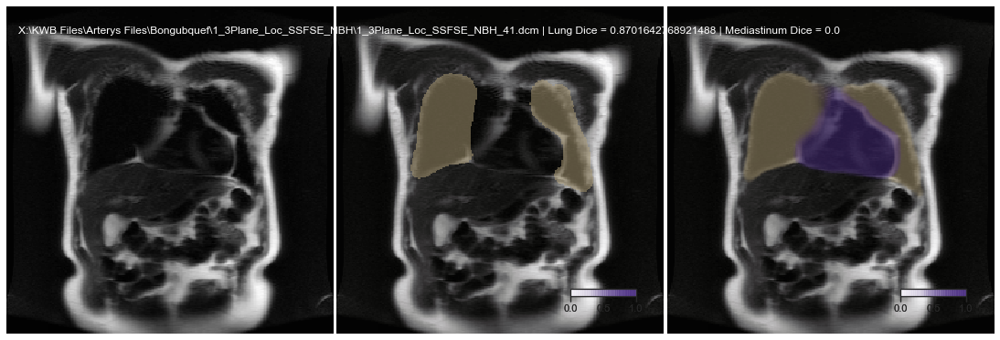

In [81]:
for i in range(161):
    plot_inference(i)
    plt.savefig(r"X:\KWB Files\3 Plane Loc\0_Notebook\Images\plot_%s.png" % i)
    plt.close


In [71]:
dice_lung[]

array([0.93277825, 0.94223249, 0.95193401, 0.95358236, 0.95530225,
       0.89544941, 0.91292358, 0.9102589 , 0.93566566, 0.93445561,
       0.95626049, 0.94767097, 0.9551282 , 0.95366469, 0.94917314,
       0.94896785, 0.9409822 , 0.93365069, 0.89509461, 0.94788319,
       0.9672636 , 0.96373476, 0.94667301, 0.95095409, 0.93893171,
       0.93586454, 0.89104684, 0.80985352, 0.84132943, 0.76756925,
       0.96656307, 0.95917843, 0.94972067, 0.92940115, 0.95461301,
       0.95051304, 0.94150617, 0.94834458, 0.91396287, 0.92867951,
       0.89163576, 0.9119769 , 0.87780821, 0.72551129, 0.21979865,
       0.93835616, 0.93869043, 0.95700245, 0.95676571, 0.95254078,
       0.95970149, 0.9635079 , 0.96010933, 0.9410698 , 0.94719673,
       0.94284386, 0.94501188, 0.86827032, 0.84859426, 0.83848795,
       0.89857394, 0.86275772, 0.88869412, 0.87056073, 0.45918047,
       0.        , 0.        , 0.        , 0.89938601, 0.90166524,
       0.93502334, 0.95397751, 0.96729792, 0.94745006, 0.92173

In [46]:
# Need to reshape data into single df with 2 columns, dice + lung/ms
import itertools
L = np.array(list(itertools.repeat("lung", 161)))
M = np.array(list(itertools.repeat("mediastinum", 161)))

In [47]:
label=np.concatenate((L,M))
dice=np.concatenate((dice_lung, dice_ms))

In [48]:
dice_lm = pd.DataFrame({'dice': dice, 'label': label})
dice_lm     

,dice,label
0,0.932778,lung
1,0.942232,lung
2,0.951934,lung
3,0.953582,lung
4,0.955302,lung
5,0.895449,lung
6,0.912924,lung
7,0.910259,lung
8,0.935666,lung
9,0.934456,lung


In [68]:
label=np.concatenate((L,M))
corr_dice=np.concatenate((corr_dice_lung, corr_dice_ms))
corr_dice_lm = pd.DataFrame({'dice': corr_dice, 'label': label})


filt_dice=corr_dice_lm.dropna()

In [69]:
filt_dice

,dice,label
51,0.963508,lung
52,0.960109,lung
53,0.941070,lung
54,0.947197,lung
55,0.942844,lung
56,0.945012,lung
57,0.868270,lung
58,0.848594,lung
59,0.838488,lung
60,0.908211,lung


[Text(0, 0.5, '')]

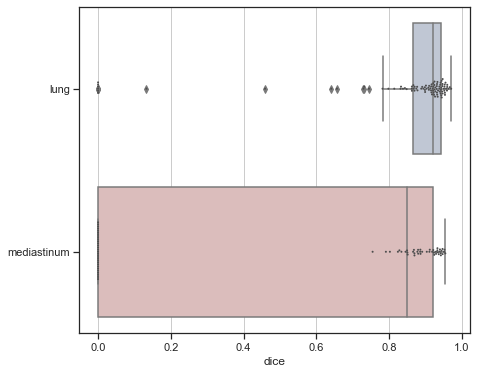

In [70]:
import seaborn as sns
sns.set(style="ticks")

# Initialize the figure
f, ax = plt.subplots(figsize=(7, 6))


# Plot the orbital period with horizontal boxes
sns.boxplot(x="dice", y="label", data=filt_dice,
            palette="vlag")

# Add in points to show each observation
sns.swarmplot(x="dice", y="label", data=filt_dice,
              size=2, color=".3", linewidth=0)

# Tweak the visual presentation
ax.xaxis.grid(True)
ax.set(ylabel="")
#sns.despine(trim=True, left=True)

In [104]:
from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score, cohen_kappa_score

In [105]:
# Confusion matrix
confusion_matrix(y_true, y_pred)

# Precision 
precision_score(x, yp)

# Recall
recall_score(x, yp)

# F1 score
f1_score(y, yp)

# Cohen's kappa
cohen_kappa_score(y, yp)

ValueError: unknown is not supported

In [47]:
# Recall
recall_score(y, yp)

# F1 score
f1_score(y, yp)

# Cohen's kappa
cohen_kappa_score(y, yp)

ValueError: unknown is not supported